### example pre-processing notebook for volumetric stacks aquired from the Bruker with visual stimuli presented
### last updated 03/21/2024

# load all imports

In [1]:
%load_ext autoreload

In [2]:
import warnings 
def action_with_warnings():
    warnings.warn("ignore")
with warnings.catch_warnings(record=True):    
    from pathlib import Path
    import os
    import pandas as pd
    from tiffile import imread, imwrite
    import glob
    import caiman as cm
    
from datetime import datetime as dt, timedelta
import matplotlib.pyplot as plt
import shutil

from tqdm.auto import tqdm
import numpy as np

In [3]:
%autoreload 
import sys
sys.path.append(r'C:\Users\NaumannLab_KEF\PyCharmProjects\imaging\caImageAnalysis') 
# append the path where analysis scripts are stored
import fishy, stimuli, process, bruker_images, utilities
from fishy import WorkingFish, BaseFish, VizStimFish, TailTrackedFish, VolumeFish, VizStimVolume

# master folder with multiple bruker stacks


In [4]:
master_folder = Path(r'D:\Imaging_Bruker\Matt\20231210_tracksinglecell_OMRstacks')

# process each volumetric stack - making ome files into folders per plane, one tif file, and moving important files over 


In [9]:
with os.scandir(master_folder) as enteries:
    for entry in enteries:
        finished_path = Path(entry.path).joinpath('output_folders')

        # make sure not grabbing pstim file and that the output_folders does not exist yet
        if (not finished_path.exists()) & ("txt" not in entry.name): 
            bruker_images.bruker_img_organization(entry.path, testkey = 'Cycle', single_plane=False, pstim_file=True)

<tifffile.TiffFile 'stack_5-016_Cyc…2_000001.ome.tif'> OME series is BinaryOnly, not an OME-TIFF master file 
<tifffile.TiffFile 'stack_5-016_Cyc…2_000001.ome.tif'> OME series is BinaryOnly, not an OME-TIFF master file 
<tifffile.TiffFile 'stack_5-016_Cyc…2_000001.ome.tif'> OME series is BinaryOnly, not an OME-TIFF master file 
<tifffile.TiffFile 'stack_5-016_Cyc…2_000001.ome.tif'> OME series is BinaryOnly, not an OME-TIFF master file 
<tifffile.TiffFile 'stack_5-016_Cyc…2_000001.ome.tif'> OME series is BinaryOnly, not an OME-TIFF master file 
<tifffile.TiffFile 'stack_5-016_Cyc…2_000001.ome.tif'> OME series is BinaryOnly, not an OME-TIFF master file 
<tifffile.TiffFile 'stack_5-016_Cyc…2_000001.ome.tif'> OME series is BinaryOnly, not an OME-TIFF master file 
<tifffile.TiffFile 'stack_5-016_Cyc…2_000001.ome.tif'> OME series is BinaryOnly, not an OME-TIFF master file 
<tifffile.TiffFile 'stack_5-016_Cyc…2_000001.ome.tif'> OME series is BinaryOnly, not an OME-TIFF master file 
<tifffile.

# run motion correction and suite2p (not photostim suite2p) processing

In [44]:
## ideal to run this overnight
with os.scandir(master_folder) as enteries:
    for entry in enteries:
        if not entry.name.endswith(".txt") : # make sure not grabbing pstim file
            paths = {}
            with os.scandir(Path(entry.path).joinpath('output_folders')) as entries:
                for entry in entries:
                    if os.path.isdir(entry.path):
                        paths[entry.name] = entry.path
            
            for p in tqdm(paths.keys()):
                if not Path(paths[p]).joinpath('suite2p').exists():
                    baseFish = BaseFish(folder_path = paths[p], frametimes_key = 'frametimes')
                    process.run_image_rotation(baseFish, angle = 90, crop = 0) #fixing image rotation, needs to happen before movement corr
                    process.run_movement_correction(baseFish, force = True)

                    baseFish = BaseFish(folder_path = paths[p], frametimes_key = 'frametimes')
                    process.run_suite2p(baseFish, force = True)

  0%|          | 0/4 [00:00<?, ?it/s]

  0%|          | 0/3 [00:00<?, ?it/s]

  0%|          | 0/6 [00:00<?, ?it/s]

  0%|          | 0/7 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

found and loaded frametimes h5
found and loaded frametimes h5


100%|██████████| 1/1 [00:02<00:00,  2.10s/it]


found and loaded frametimes h5
found and loaded frametimes h5
{}
tif
** Found 1 tifs - converting to binary **
2000 frames of binary, time 7.34 sec.
time 12.55 sec. Wrote 3500 frames per binary for 1 planes
>>>>>>>>>>>>>>>>>>>>> PLANE 0 <<<<<<<<<<<<<<<<<<<<<<
NOTE: not registered / registration forced with ops['do_registration']>1
      (no previous offsets to delete)
NOTE: applying default C:\Users\NaumannLab_KEF\.suite2p\classifiers\classifier_user.npy
----------- REGISTRATION
Reference frame, 20.24 sec.
Registered 500/3500 in 26.07s
Registered 1000/3500 in 51.91s
Registered 1500/3500 in 77.77s
Registered 2000/3500 in 103.52s
Registered 2500/3500 in 129.63s
Registered 3000/3500 in 155.86s
Registered 3500/3500 in 181.82s
----------- Total 207.98 sec
Registration metrics, 22.30 sec.
----------- ROI DETECTION
Binning movie in chunks of length 02
Binned movie of size [1750,494,496] created in 3.05 sec.


c:\Users\NaumannLab_KEF\mambaforge\envs\caiman2\lib\site-packages\suite2p\detection\sparsedetect.py:271: UserWarning: Spatial scale estimation failed.  Setting spatial scale to 1 in order to continue.
  warn("Spatial scale estimation failed.  Setting spatial scale to 1 in order to continue.")


NOTE: FORCED spatial scale ~6 pixels, time epochs 1.46, threshold 7.29 
0 ROIs, score=216.18
1000 ROIs, score=30.20
2000 ROIs, score=28.54
3000 ROIs, score=27.47
4000 ROIs, score=26.63
Detected 5000 ROIs, 30.47 sec
['compact', 'npix_norm']
Preclassify threshold 0.15, 4808 ROIs removed
After removing overlaps, 189 ROIs remain
----------- Total 35.81 sec.
----------- EXTRACTION
Masks created, 0.19 sec.
Extracted fluorescence from 189 ROIs in 3500 frames, 7.18 sec.
----------- Total 7.67 sec.
----------- CLASSIFICATION
['skew', 'compact', 'npix_norm']
----------- SPIKE DECONVOLUTION
----------- Total 0.03 sec.
Plane 0 processed in 274.20 sec (can open in GUI).
total = 287.11 sec.
TOTAL RUNTIME 287.11 sec


  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

  0%|          | 0/5 [00:00<?, ?it/s]

# make central vol processing class for each stack, need to put into a dictionary since multiple stacks

In [45]:
fishvolume_dict = {}

with os.scandir(master_folder) as entries:
    for entry in entries:
        if entry.name.endswith(".txt"):
            pass
        else:
            k = entry.name.split('-')[0].split('_')[1]
            if k not in fishvolume_dict.keys():
                fishvolume_dict[k] = {}

            paths = {}
            with os.scandir(Path(entry.path).joinpath('output_folders')) as entries:
                for entry in entries:
                    if os.path.isdir(entry.path):
                        paths[entry.name] = entry.path
            
                
            fishvolume = VizStimVolume()
            try:
                for p in tqdm(paths.keys()):    
                    afish = WorkingFish(
                        folder_path=paths[p],
                        frametimes_key="frametimes",
                        stim_key="txt",
                        stim_fxn=stimuli.pandastim_to_df,
                        invert=False,
                        used_offsets = (-10, 16),
                        stim_offset = 7,
                        corr_threshold=0.8
                    )  # make a fish

                    fishvolume.add_volume(afish)  # add them to volume
            except:

                print(f'bad fish in {paths}')
            
            fishvolume_dict[k] = fishvolume

  0%|          | 0/4 [00:00<?, ?it/s]

found and loaded frametimes h5


c:\Users\NaumannLab_KEF\mambaforge\envs\caiman2\lib\site-packages\pandas\core\generic.py:5516: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  self[name] = value


found and loaded frametimes h5
found and loaded frametimes h5
found and loaded frametimes h5


  0%|          | 0/3 [00:00<?, ?it/s]

found and loaded frametimes h5
found and loaded frametimes h5
found and loaded frametimes h5


  0%|          | 0/6 [00:00<?, ?it/s]

found and loaded frametimes h5
found and loaded frametimes h5
found and loaded frametimes h5
found and loaded frametimes h5
found and loaded frametimes h5
found and loaded frametimes h5


  0%|          | 0/7 [00:00<?, ?it/s]

found and loaded frametimes h5
bad fish in {'plane_0': 'D:\\Imaging_Bruker\\Matt\\20231210_tracksinglecell_OMRstacks\\stack_003\\output_folders\\plane_0', 'plane_1': 'D:\\Imaging_Bruker\\Matt\\20231210_tracksinglecell_OMRstacks\\stack_003\\output_folders\\plane_1', 'plane_2': 'D:\\Imaging_Bruker\\Matt\\20231210_tracksinglecell_OMRstacks\\stack_003\\output_folders\\plane_2', 'plane_3': 'D:\\Imaging_Bruker\\Matt\\20231210_tracksinglecell_OMRstacks\\stack_003\\output_folders\\plane_3', 'plane_4': 'D:\\Imaging_Bruker\\Matt\\20231210_tracksinglecell_OMRstacks\\stack_003\\output_folders\\plane_4', 'plane_5': 'D:\\Imaging_Bruker\\Matt\\20231210_tracksinglecell_OMRstacks\\stack_003\\output_folders\\plane_5', 'plane_6': 'D:\\Imaging_Bruker\\Matt\\20231210_tracksinglecell_OMRstacks\\stack_003\\output_folders\\plane_6'}


  0%|          | 0/5 [00:00<?, ?it/s]

found and loaded frametimes h5
found and loaded frametimes h5
found and loaded frametimes h5
found and loaded frametimes h5
found and loaded frametimes h5


  0%|          | 0/5 [00:00<?, ?it/s]

found and loaded frametimes h5
found and loaded frametimes h5
found and loaded frametimes h5
found and loaded frametimes h5
found and loaded frametimes h5


  0%|          | 0/5 [00:00<?, ?it/s]

found and loaded frametimes h5
found and loaded frametimes h5
found and loaded frametimes h5
found and loaded frametimes h5
found and loaded frametimes h5


  0%|          | 0/5 [00:00<?, ?it/s]

found and loaded frametimes h5
found and loaded frametimes h5
found and loaded frametimes h5
found and loaded frametimes h5
found and loaded frametimes h5


  0%|          | 0/5 [00:00<?, ?it/s]

found and loaded frametimes h5
found and loaded frametimes h5
found and loaded frametimes h5
found and loaded frametimes h5
found and loaded frametimes h5


  0%|          | 0/5 [00:00<?, ?it/s]

found and loaded frametimes h5
found and loaded frametimes h5
found and loaded frametimes h5
found and loaded frametimes h5
found and loaded frametimes h5


  0%|          | 0/5 [00:00<?, ?it/s]

found and loaded frametimes h5
bad fish in {'plane_0': 'D:\\Imaging_Bruker\\Matt\\20231210_tracksinglecell_OMRstacks\\stack_010\\output_folders\\plane_0', 'plane_1': 'D:\\Imaging_Bruker\\Matt\\20231210_tracksinglecell_OMRstacks\\stack_010\\output_folders\\plane_1', 'plane_2': 'D:\\Imaging_Bruker\\Matt\\20231210_tracksinglecell_OMRstacks\\stack_010\\output_folders\\plane_2', 'plane_3': 'D:\\Imaging_Bruker\\Matt\\20231210_tracksinglecell_OMRstacks\\stack_010\\output_folders\\plane_3', 'plane_4': 'D:\\Imaging_Bruker\\Matt\\20231210_tracksinglecell_OMRstacks\\stack_010\\output_folders\\plane_4'}


  0%|          | 0/5 [00:00<?, ?it/s]

found and loaded frametimes h5
found and loaded frametimes h5
found and loaded frametimes h5
found and loaded frametimes h5
found and loaded frametimes h5


  0%|          | 0/5 [00:00<?, ?it/s]

found and loaded frametimes h5
found and loaded frametimes h5
found and loaded frametimes h5
found and loaded frametimes h5
found and loaded frametimes h5


  0%|          | 0/5 [00:00<?, ?it/s]

found and loaded frametimes h5
found and loaded frametimes h5
found and loaded frametimes h5
found and loaded frametimes h5
found and loaded frametimes h5


In [49]:
fishvolume_dict

{'000': <fishy.VizStimVolume at 0x12f92e355c8>,
 '001': <fishy.VizStimVolume at 0x12f930de708>,
 '002': <fishy.VizStimVolume at 0x12f8fe42bc8>,
 '003': <fishy.VizStimVolume at 0x12f8ec7d488>,
 '004': <fishy.VizStimVolume at 0x12f99a74b08>,
 '005': <fishy.VizStimVolume at 0x12f99a5a588>,
 '006': <fishy.VizStimVolume at 0x12f96c7ae48>,
 '007': <fishy.VizStimVolume at 0x12f99652908>,
 '008': <fishy.VizStimVolume at 0x12f972f8548>,
 '009': <fishy.VizStimVolume at 0x12f98c47608>,
 '010': <fishy.VizStimVolume at 0x12f9970d888>,
 '011': <fishy.VizStimVolume at 0x12f98c8bf48>,
 '012': <fishy.VizStimVolume at 0x12f9718cac8>,
 '013': <fishy.VizStimVolume at 0x12f930fd148>}

# visualize each brightness stack

  0%|          | 0/4 [00:00<?, ?it/s]

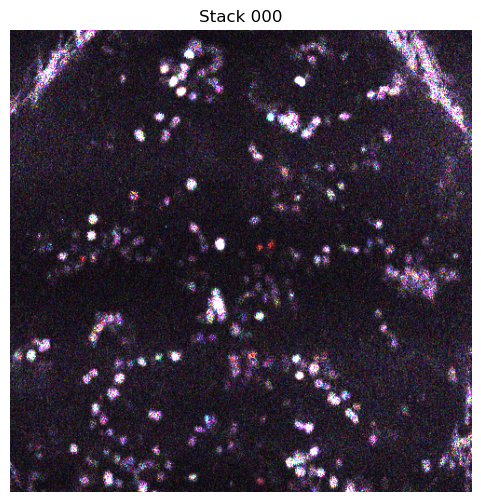

  0%|          | 0/3 [00:00<?, ?it/s]

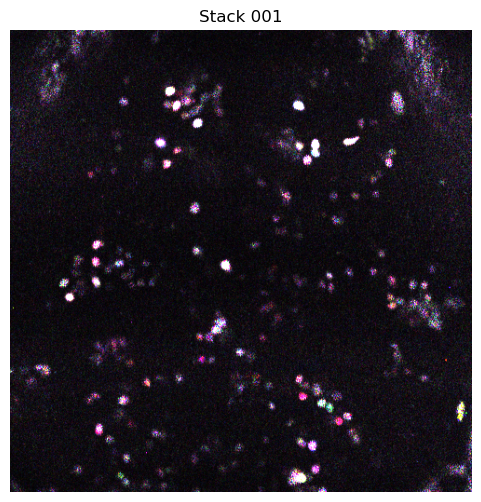

  0%|          | 0/6 [00:00<?, ?it/s]

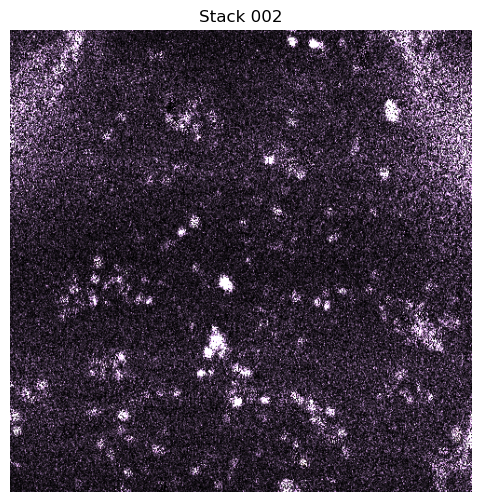

0it [00:00, ?it/s]

003


  0%|          | 0/5 [00:00<?, ?it/s]

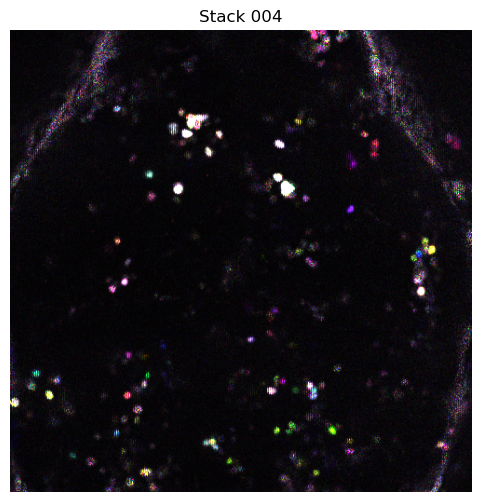

  0%|          | 0/5 [00:00<?, ?it/s]

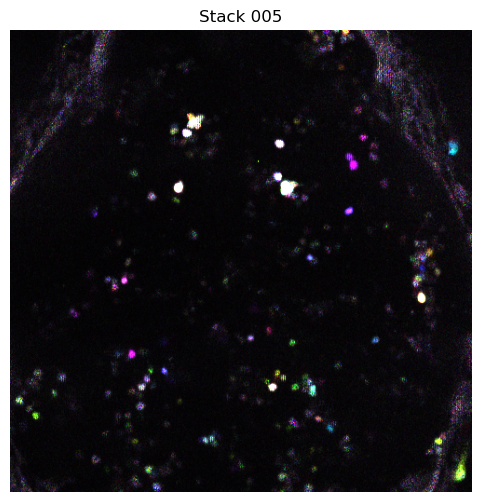

  0%|          | 0/5 [00:00<?, ?it/s]

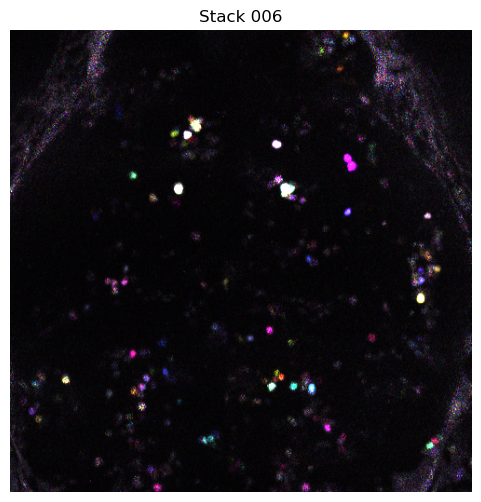

  0%|          | 0/5 [00:00<?, ?it/s]

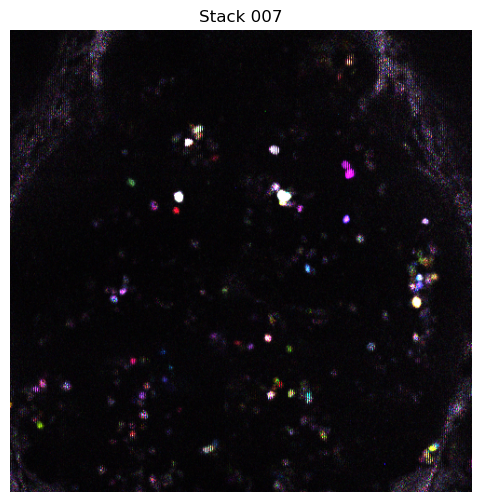

  0%|          | 0/5 [00:00<?, ?it/s]

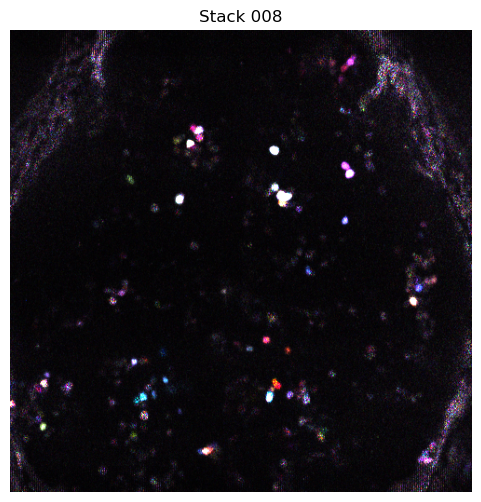

  0%|          | 0/5 [00:00<?, ?it/s]

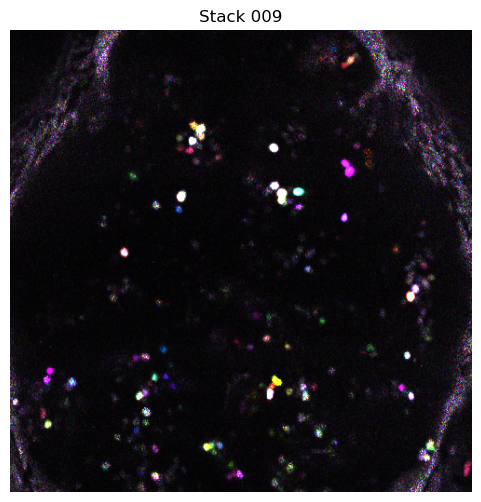

0it [00:00, ?it/s]

010


  0%|          | 0/5 [00:00<?, ?it/s]

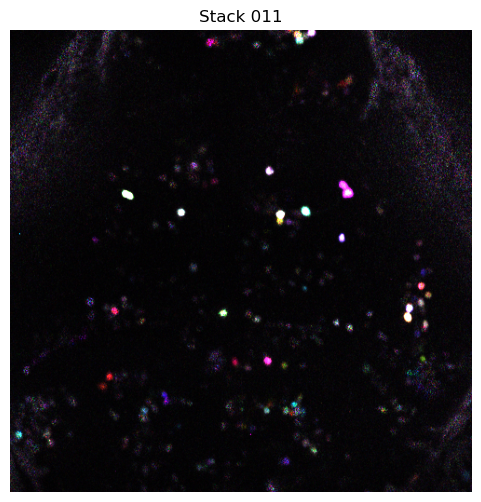

  0%|          | 0/5 [00:00<?, ?it/s]

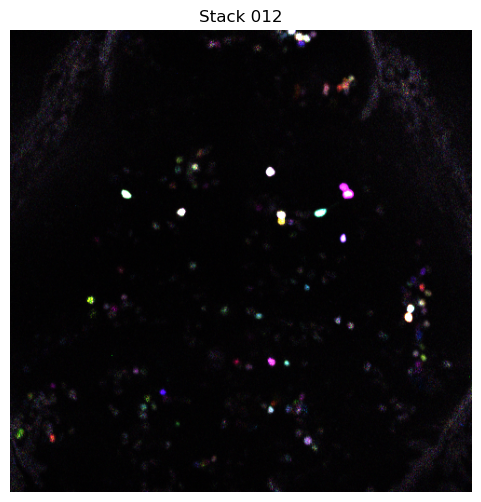

  0%|          | 0/5 [00:00<?, ?it/s]

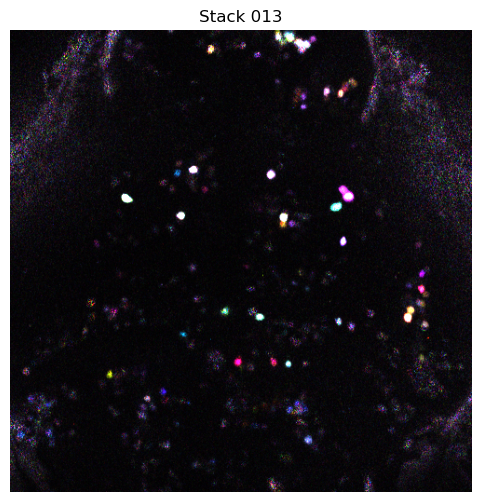

In [47]:
for stack, fv in fishvolume_dict.items():
    try:
        fv.add_diff_imgs(brightnessFactor=10)

        # process in the diff imgs
        vdiff = fv.volume_diff()

        plt.figure(figsize=(6, 6))
        plt.imshow(vdiff)
        plt.axis("off")
        plt.title(f"Stack {stack}")
        plt.show()
    except:
        print(stack)

# visualize each commputed difference stack

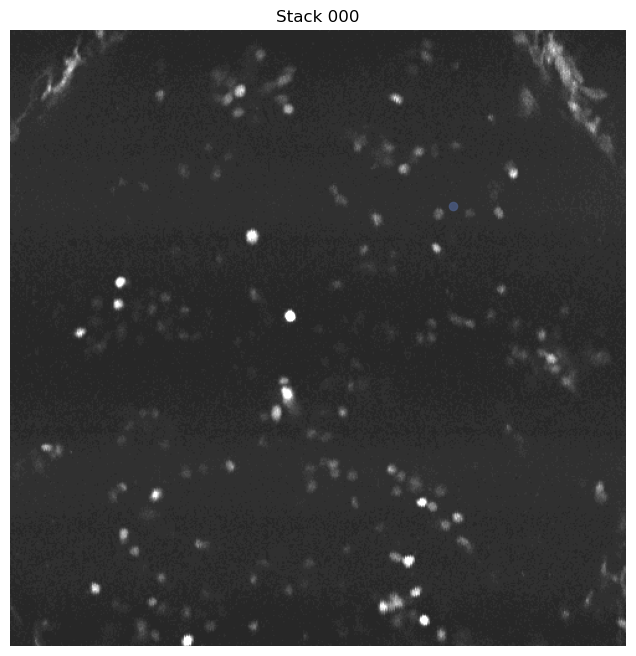

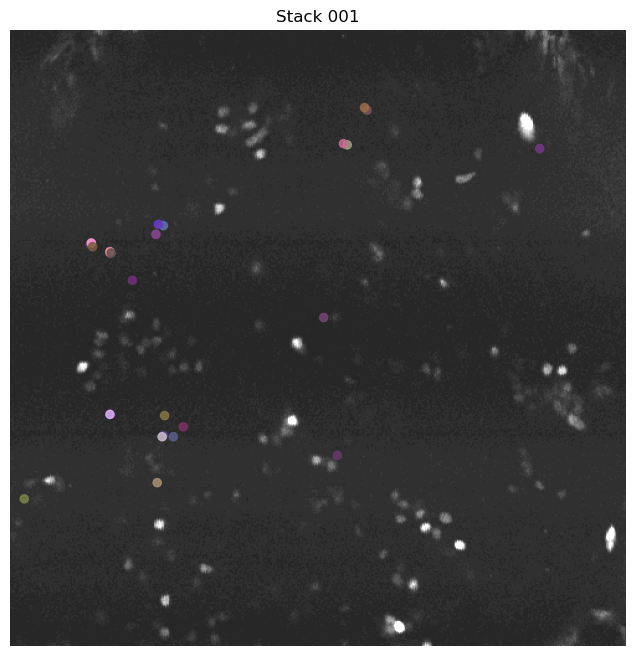

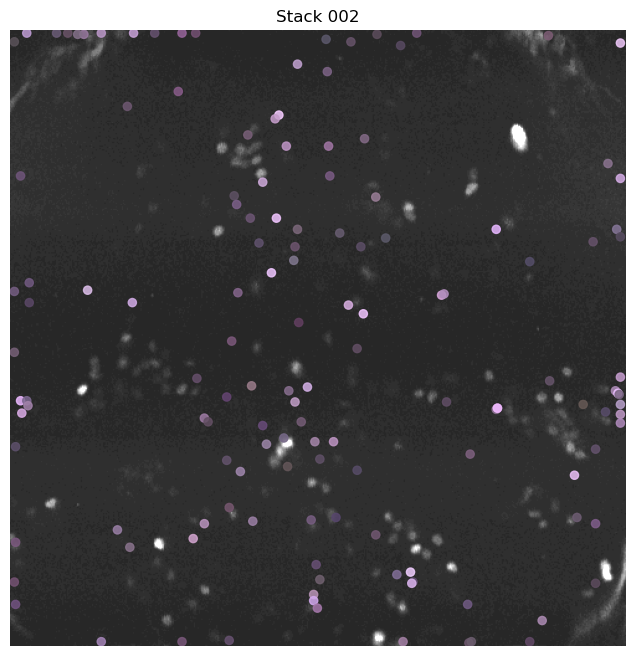

003


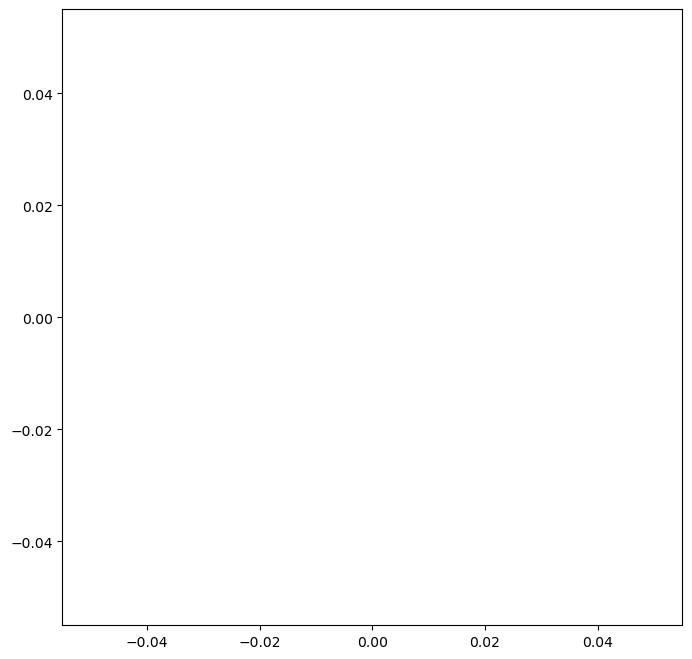

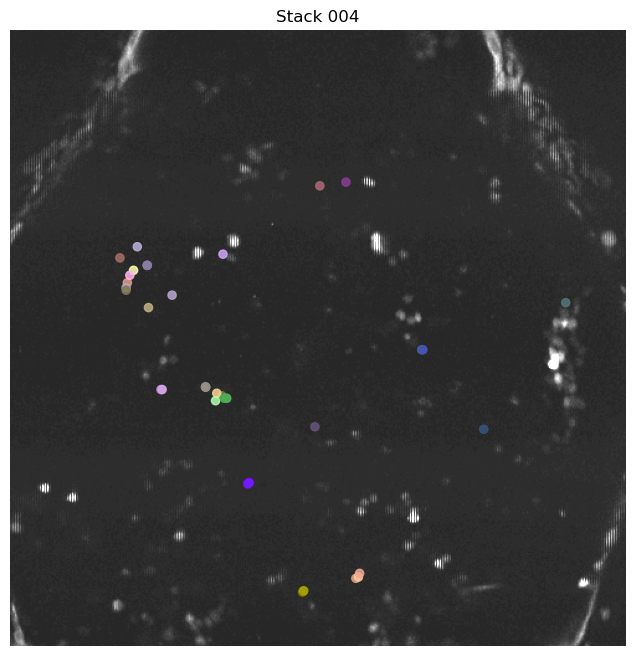

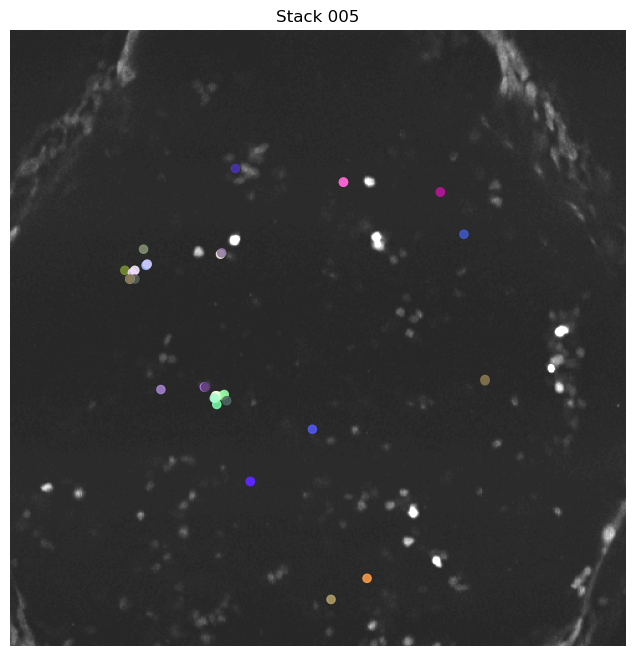

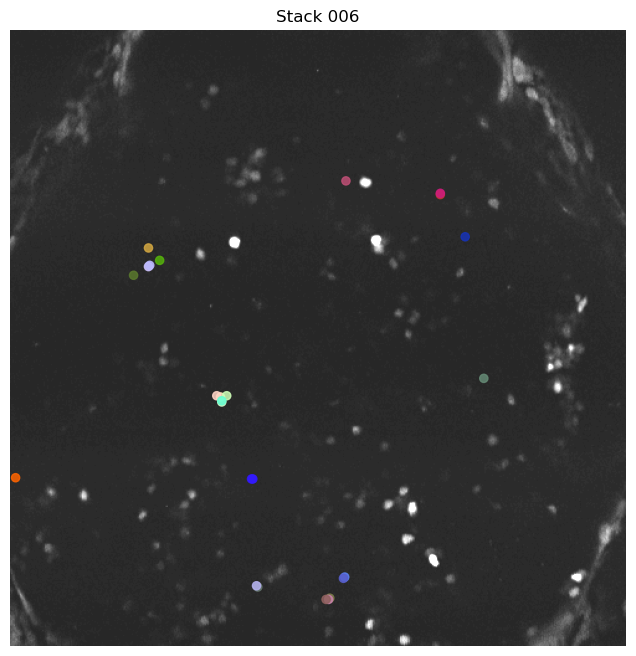

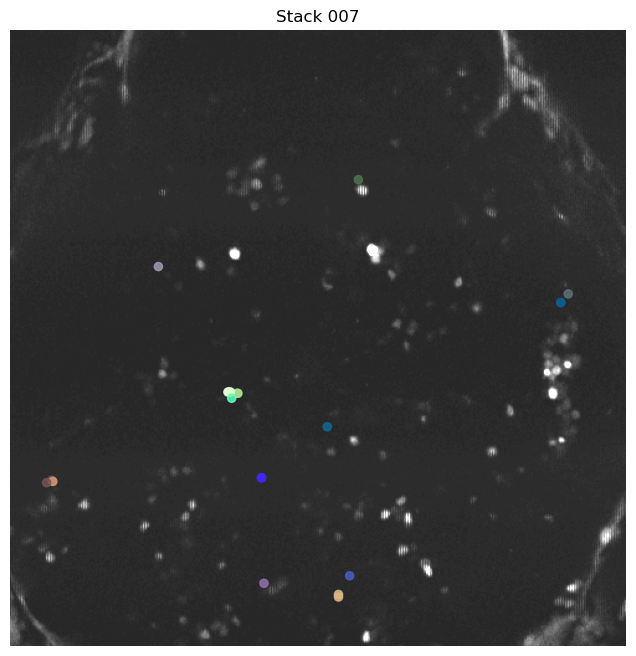

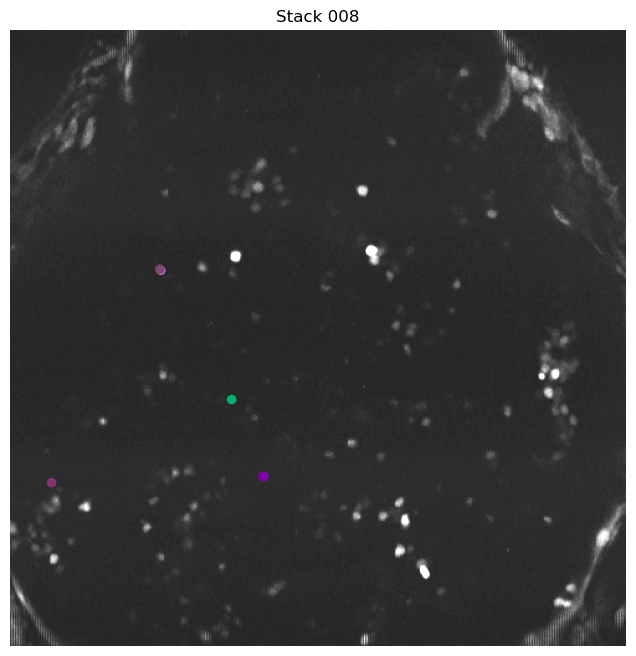

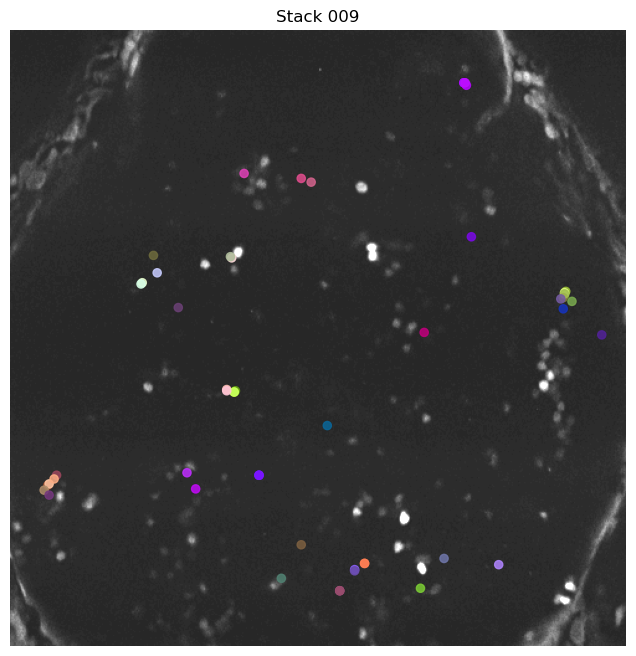

010


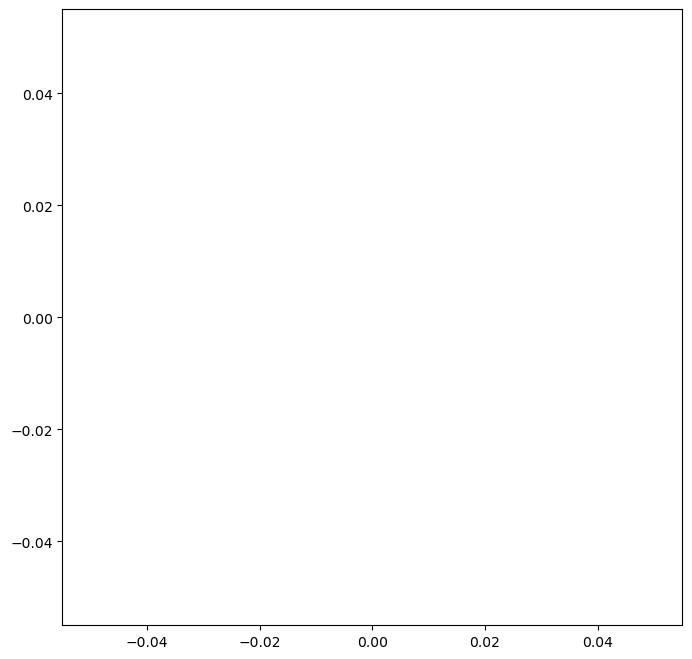

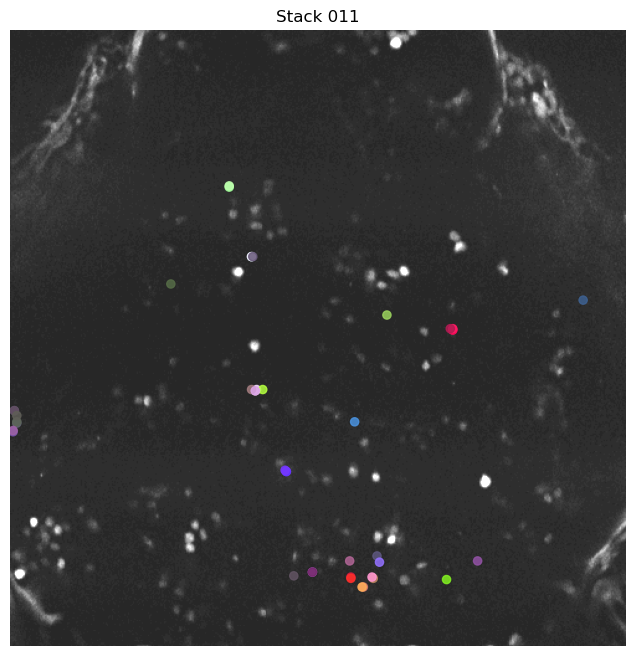

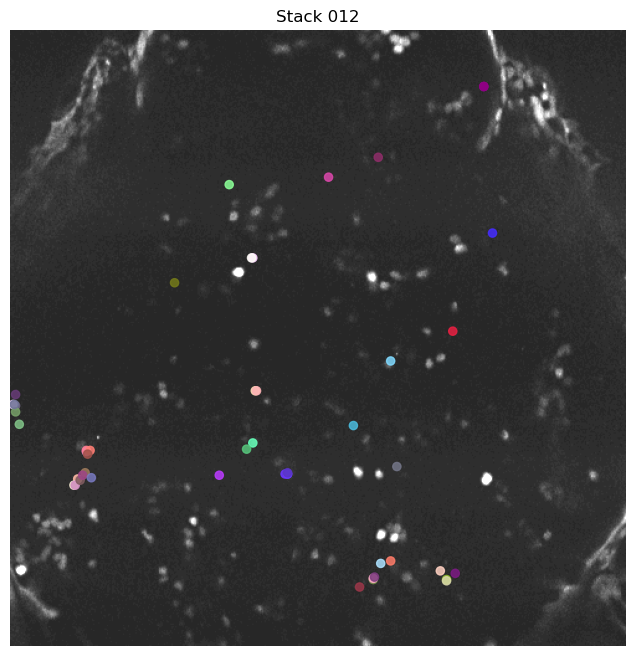

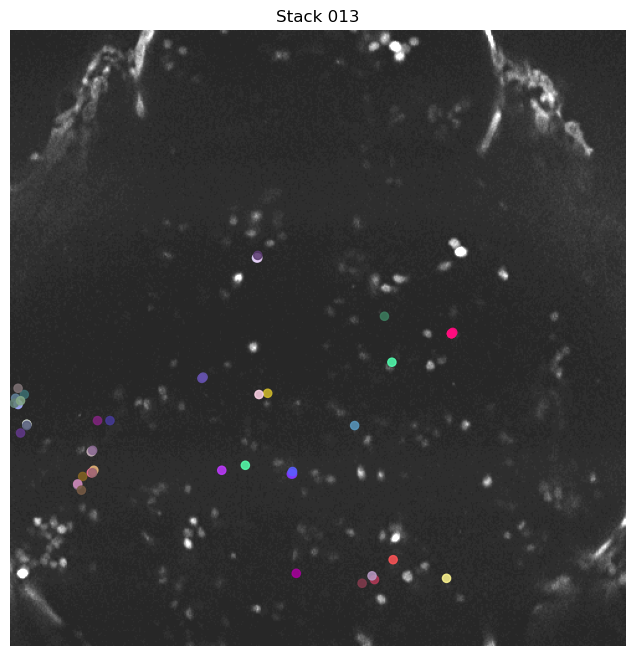

In [48]:
# do cool volume stuff
for stack, fv in fishvolume_dict.items():
    try:
        xpos, ypos, colors, neurons = fv.volume_computed_image(colorsumthresh=1)

        plt.figure(figsize=(8, 8))
        plt.scatter(xpos, ypos, color=colors, alpha=0.85, s=35)
        plt.imshow(
            fv[2].ops["refImg"],
            cmap="gray",
            alpha=0.85,
            vmax=np.percentile(fv[2].ops["refImg"], 99.9),
        )
        plt.axis("off")
        plt.title(f"Stack {stack}")
        plt.show()
    except:
        print(stack)

In [ ]:
# look at neuron traces in relation to stim on, checking for offsets

sample_fish = fishvolume[0]
plot_img =  sample_fish.ops["refImg"]

rois = sample_fish.return_cell_rois(range(len(sample_fish.f_cells)))
normcells = utilities.arrutils.norm_fdff(sample_fish.f_cells)
nrns = [normcells[n] for n in neurons[20:40]]

plt.figure(figsize=(20,10))
for z in range(15):
    plt.plot(np.arange(len(nrns[z])), nrns[z] + z, color="black")
    
frames = sample_fish.stimulus_df['frame'].values
stimmies = sample_fish.stimulus_df['stim_name'].values
sample_fish.stim_offset = 7
stimuli.stim_shader(sample_fish)

plt.xlim(0,500)    
plt.show()